In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import collections
import time
from sklearn.metrics import accuracy_score

## Data Preprocessing

In [23]:
# read datafiles
list_apa = []
list_hou = []
for i in range(22, 26):
    hou = pd.read_csv(f'../data/curated/match_house{i}.csv')
    apa = pd.read_csv(f'../data/curated/match_apartment{i}.csv')
    list_apa.append(apa)
    list_hou.append(hou)
    


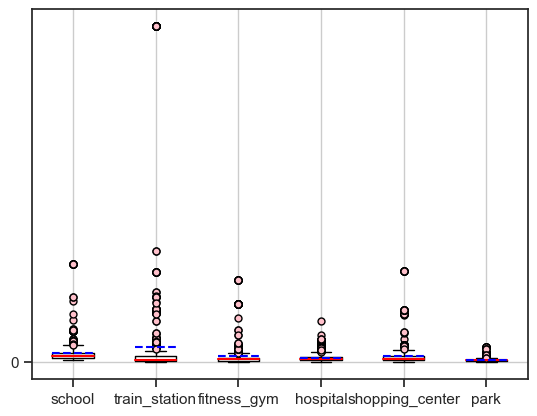

In [24]:
#boxplot-house-facilities to see the distribution and  outlier yr22
df_h = list_hou[0]
labels = 'school','train_station', 'fitness_gym', 'hospital', 'shopping_center', 'park'
school = df_h.school
train_station = df_h.train_station
fitness_gym = df_h.fitness_gym
hospital = df_h.hospital
shopping_center = df_h.shopping_center
park = df_h.park

plt.grid(True) 
plt.boxplot([school, train_station, fitness_gym, hospital, shopping_center, park],
            medianprops={'color': 'red', 'linewidth': '1.5'},
            meanline=True,
            showmeans=True,
            meanprops={'color': 'blue', 'ls': '--', 'linewidth': '1.5'},
            flierprops={"marker": "o", "markerfacecolor": "pink", "markersize": 5},
            labels=labels)
plt.yticks(np.arange(0, 5000, 50000))
plt.savefig("../plots/boxplot-house-facilities.png")
plt.show()


There are some outliers in the graph

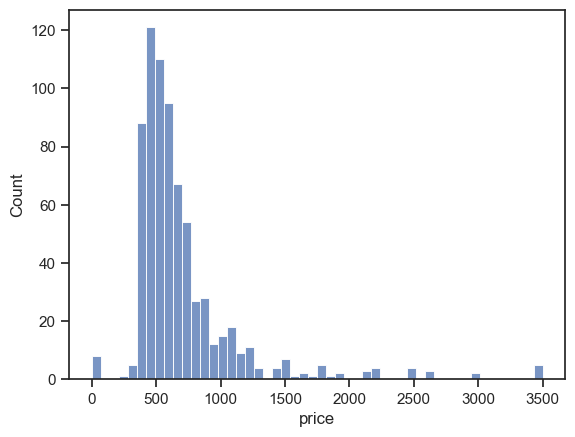

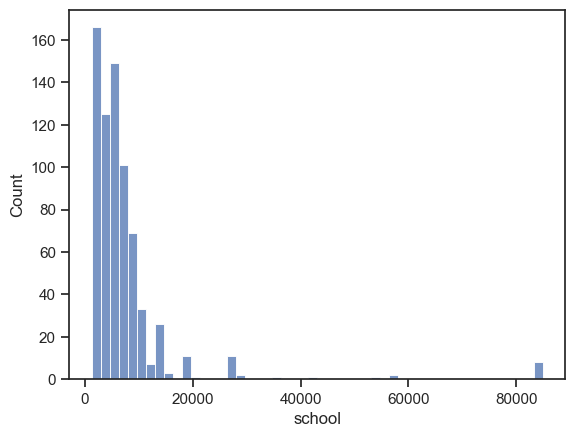

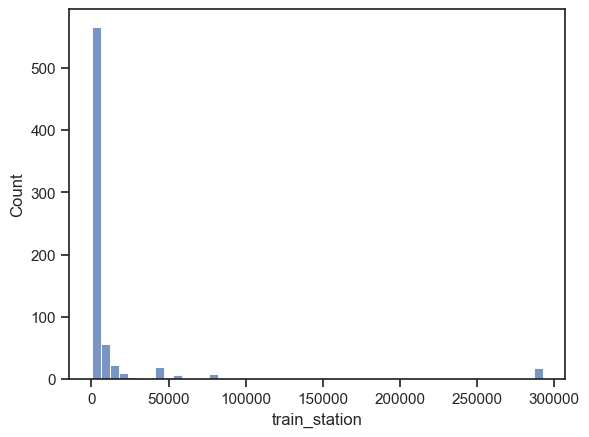

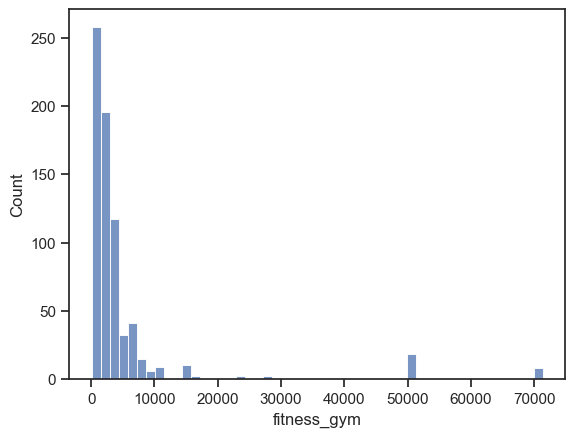

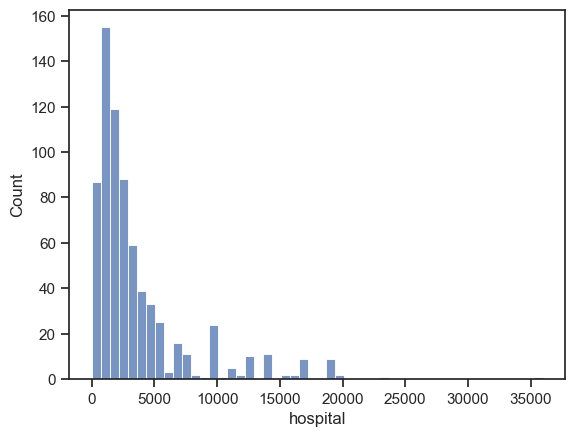

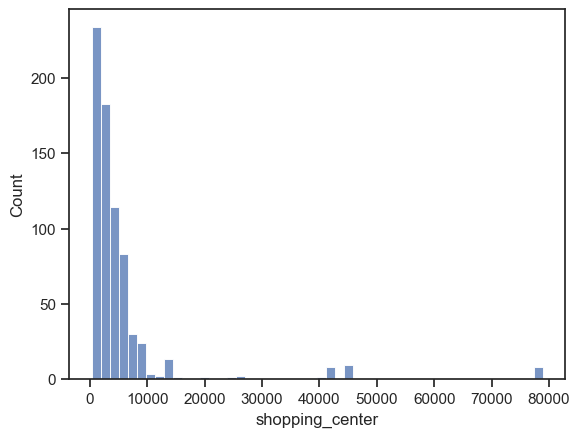

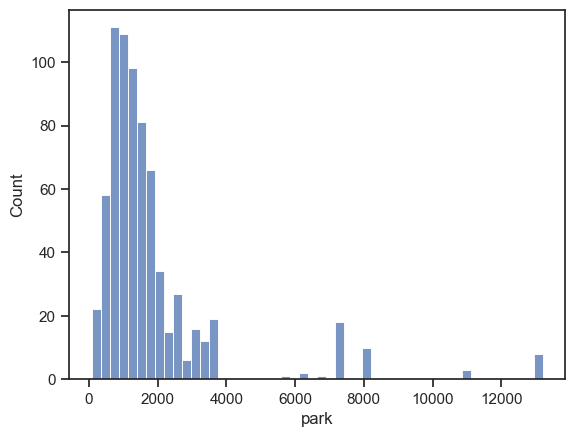

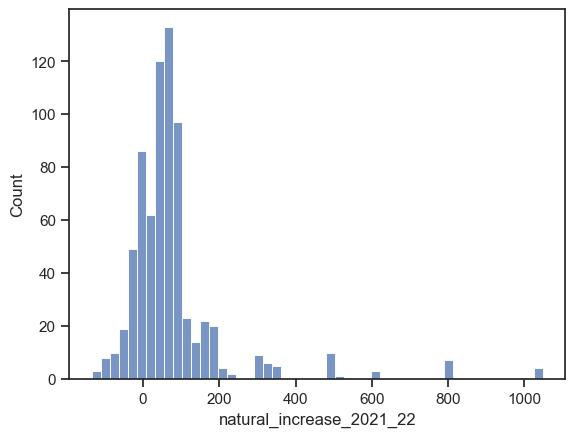

In [25]:
#selecting data for house
for i in ['price','school','train_station','fitness_gym','hospital','shopping_center','park','natural_increase_2021_22']:
    sns.histplot(df_h[i],bins=50)
    plt.show()

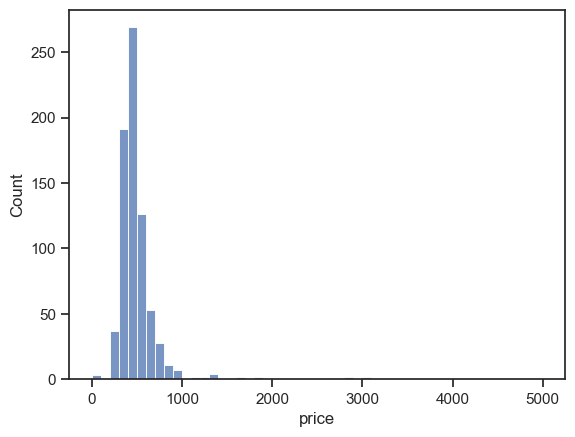

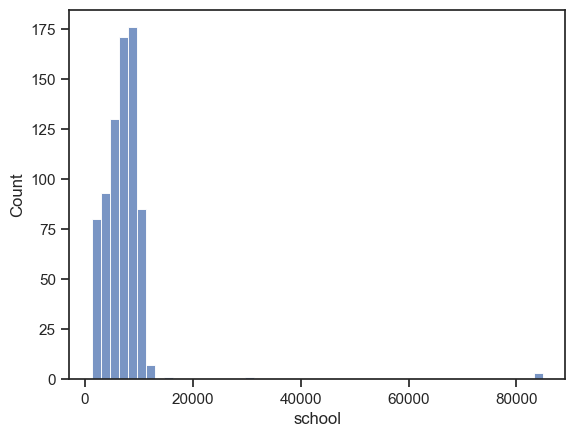

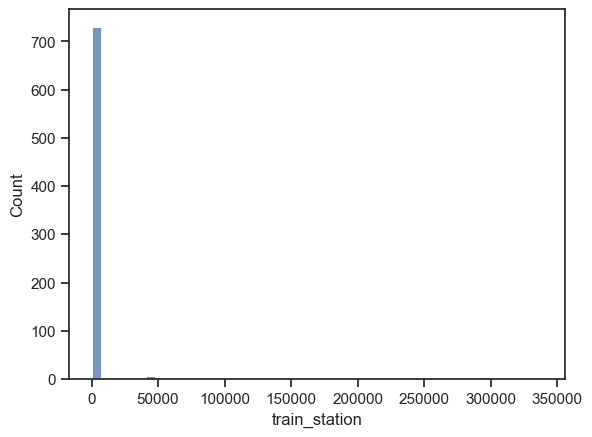

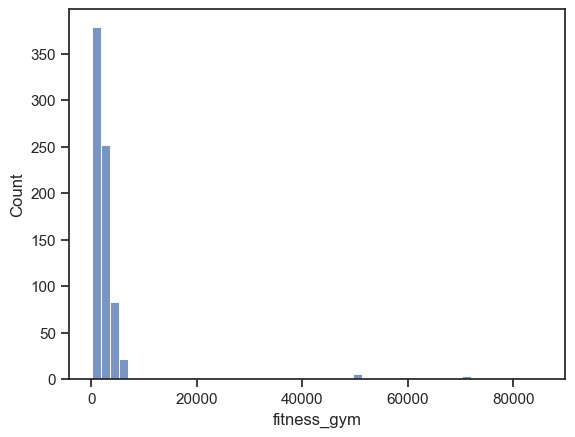

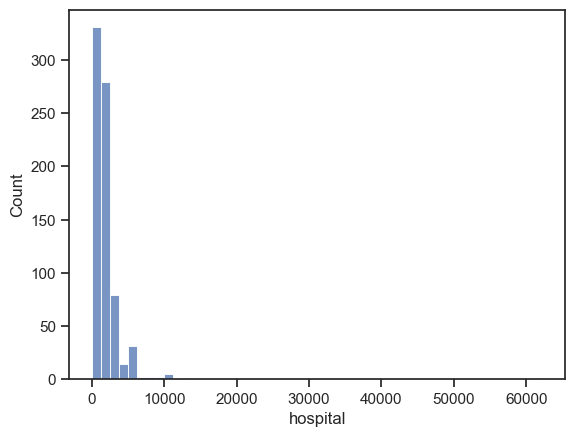

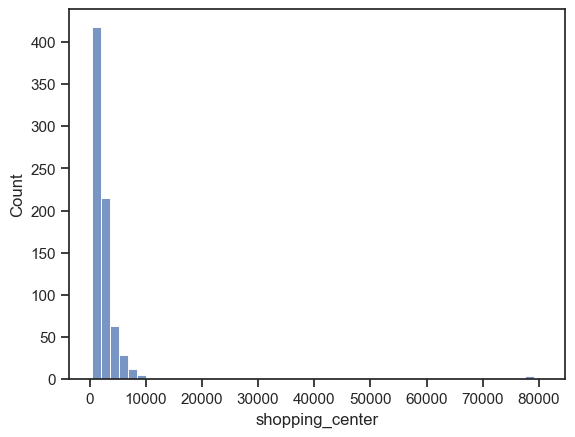

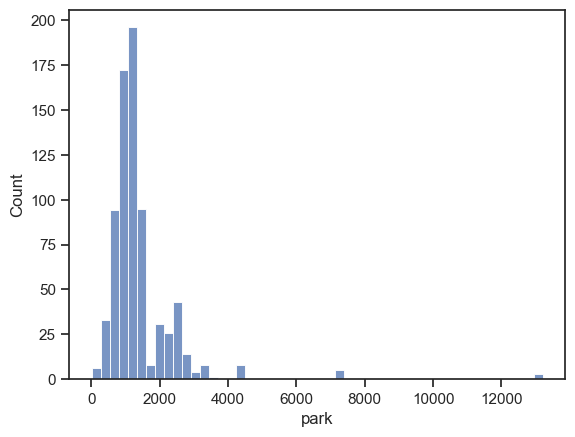

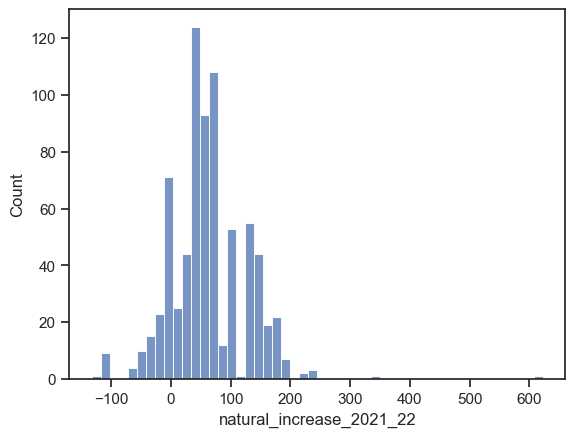

In [26]:
#selecting data for apartment
for i in ['price','school','train_station','fitness_gym','hospital','shopping_center','park','natural_increase_2021_22']:
    sns.histplot(list_apa[0][i],bins=50)
    plt.show()

In [39]:
#delete outlier/ extreme points for house and apartment

for i in range(len(list_apa)):
    df_h = list_hou[i]
    df_a = list_apa[i]
    df = df_h[df_h['price']<=2000] #Exorbitant rents may related to luxurious decoration
    df = df_h[df_h['price']>100]   #rent price should be positive
    df = df_h[df_h['school']<=40000]
    df = df_h[df_h['train_station']<=50000]
    df = df_h[df_h['fitness_gym']<=40000]
    df = df_h[df_h['hospital']<=20000]
    df = df_h[df_h['shopping_center']<=50000]
    df = df_h[df_h['park']<=10000]
    df = df.dropna(how ="any")
    list_hou[i] = df
    print(df.shape)
    df.to_csv(f'../data/curated/match_house{i+22}_s.csv')
    df = df_a[df_a['price']<=2000] 
    df = df_a[df_a['price']>100]  
    df = df_a[df_a['school']<=40000]
    df = df_a[df_a['train_station']<=50000]
    df = df_a[df_a['fitness_gym']<=40000]
    df = df_a[df_a['hospital']<=20000]
    df = df_a[df_a['shopping_center']<=50000]
    df = df_a[df_a['park']<=10000]
    df = df.dropna(how ="any")
    list_apa[i] = df
    print(df.shape)
    df.to_csv(f'../data/curated/match_apartment{i+22}_s.csv')

(706, 21)
(744, 21)
(705, 21)
(743, 21)
(706, 21)
(744, 21)
(706, 21)
(744, 21)


Question 1

In [28]:
#pip install pandas_profiling

In [29]:
import pandas_profiling as ppf
# find the relationship between features to select the best ones
house22 = pd.read_csv("../data/curated/match_house22_s.csv")
house22.drop(['Unnamed: 0.2', 'Unnamed: 0.1', 'Unnamed: 0'], axis=1, inplace=True)

In [30]:
# report on data
ppf.ProfileReport(house22)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Find Correlation
important internal factors: #beds; #baths; \
important external factors: #hospital; #train_station; #net_overseas_migration

/Users/yaojie/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


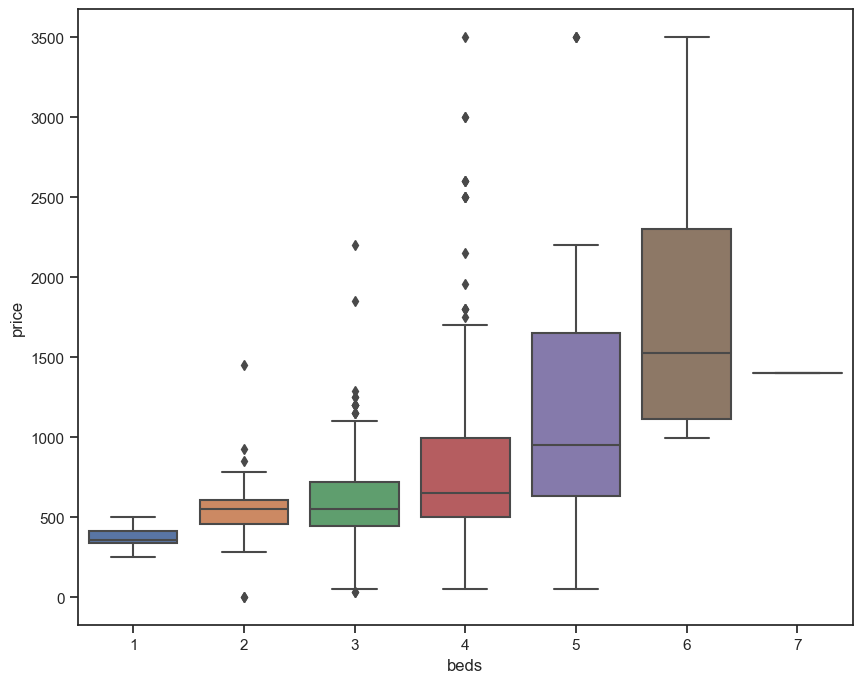

In [31]:
plt.figure(figsize=(10,8))
sns.boxplot(house22.beds, house22.price)
plt.savefig("../plots/beds vs price.png")
plt.show()


Price increases as the number of beads increasea

/Users/yaojie/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


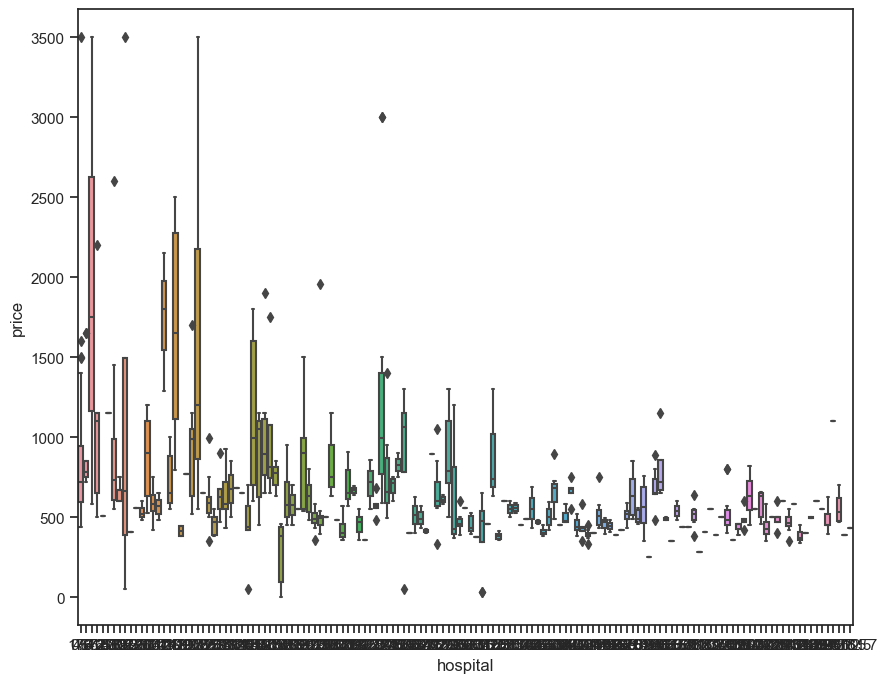

In [32]:
plt.figure(figsize=(10,8))
sns.boxplot(house22.hospital, house22.price)
plt.savefig("../plots/hospital vs price.png")
plt.show()


/Users/yaojie/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


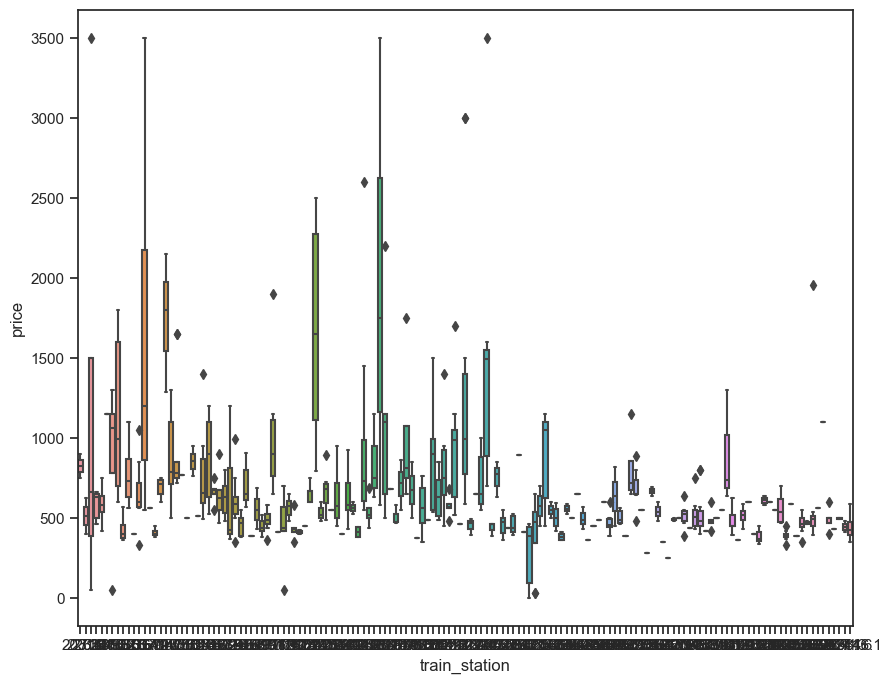

In [33]:
plt.figure(figsize=(10, 8))
sns.boxplot(house22.train_station, house22.price)
plt.savefig("../plots/train_station vs price.png")
plt.show()


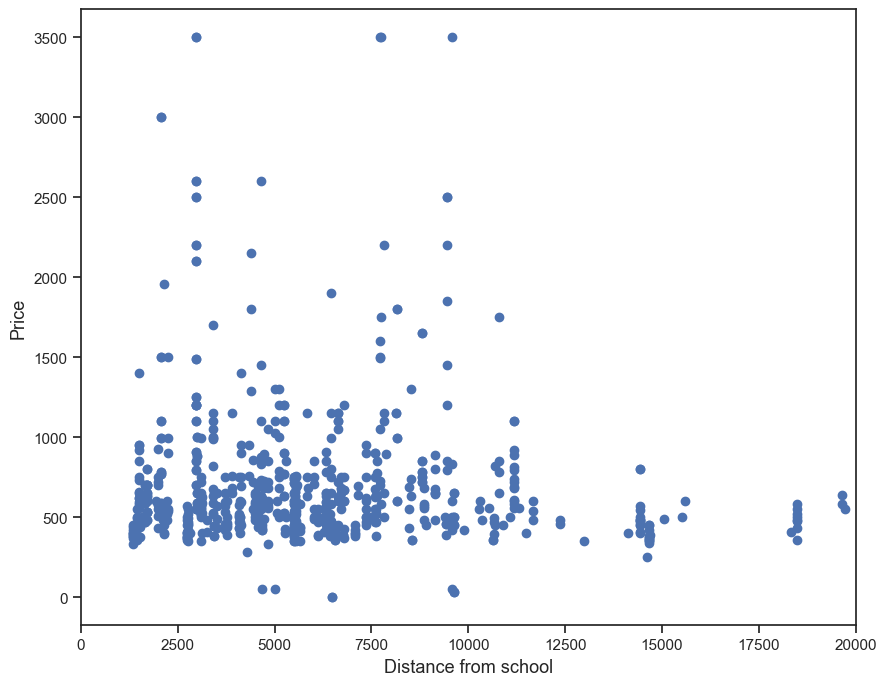

In [34]:
plt.figure(figsize=(10,8))
plt.xlim(0,20000)
plt.scatter(x=house22.school, y=house22.price)
plt.xlabel("Distance from school", fontsize=13)
plt.ylabel("Price", fontsize=13)
plt.savefig("../plots/school vs price.png")
plt.show()

In [35]:
coddrrmat = house22.corr()
coddrrmat.sort_values('price',ascending=False)

,price,beds,baths,parking,latitudes,longitudes,school,train_station,fitness_gym,hospital,shopping_center,park,2022income,2022house_price,erp_2022,net_internal_migration_2021_22,net_overseas_migration_2021_22,natural_increase_2021_22
price,1.000000,0.415146,0.541754,0.177256,-0.098205,-0.064829,-0.093755,-0.126520,-0.150629,-0.264789,-0.077305,-0.147895,0.053142,0.167080,-0.006922,-0.062589,-0.079844,-0.170805
baths,0.541754,0.616048,1.000000,0.336043,-0.076512,-0.035096,0.031918,-0.039225,-0.026521,0.028050,0.073251,0.011496,0.032506,0.089017,0.013578,0.061193,0.033638,0.005765
beds,0.415146,1.000000,0.616048,0.393141,-0.055632,0.026161,0.053500,-0.005411,0.004813,0.055416,0.070381,0.036353,0.040698,0.089351,0.034771,0.051970,0.062385,-0.002787
parking,0.177256,0.393141,0.336043,1.000000,-0.031233,0.087711,0.077348,0.059068,0.070729,0.095273,0.073620,0.042260,0.007413,0.114137,0.010819,0.069572,0.115073,0.032131
2022house_price,0.167080,0.089351,0.089017,0.114137,-0.252693,-0.230742,-0.126053,-0.301683,-0.298095,-0.141251,-0.165416,-0.306262,-0.128019,1.000000,-0.205278,-0.154990,0.121143,-0.233705
2022income,0.053142,0.040698,0.032506,0.007413,0.116669,0.056940,-0.011837,0.132488,0.153226,-0.009538,0.030205,0.159289,1.000000,-0.128019,0.960162,0.206572,-0.235625,0.549805
erp_2022,-0.006922,0.034771,0.013578,0.010819,0.123659,0.052451,0.002632,0.145907,0.170033,0.034037,0.046641,0.219299,0.960162,-0.205278,1.000000,0.273032,-0.341596,0.603917
net_internal_migration_2021_22,-0.062589,0.051970,0.061193,0.069572,0.079591,0.030679,0.083918,0.211395,0.164885,0.290707,0.328942,0.331047,0.206572,-0.154990,0.273032,1.000000,0.153320,0.580802
longitudes,-0.064829,0.026161,-0.035096,0.087711,0.570092,1.000000,-0.041081,0.738572,0.728943,0.129115,0.386115,0.489104,0.056940,-0.230742,0.052451,0.030679,0.076107,-0.146442
shopping_center,-0.077305,0.070381,0.073251,0.073620,-0.054542,0.386115,0.143576,0.245429,0.245751,0.396639,1.000000,0.265360,0.030205,-0.165416,0.046641,0.328942,0.177927,0.073935


##Q1 ##


From the heatmap above, we can see the correlation between features and price. The most important interal features are bathroom number, beds number, which is positively associated with the size of domain. And for external features, the distance to hospital shows higest relationship, followed by the distance to park.

/Users/yaojie/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Skewness: 3.272747
Kurtosis: 13.744488


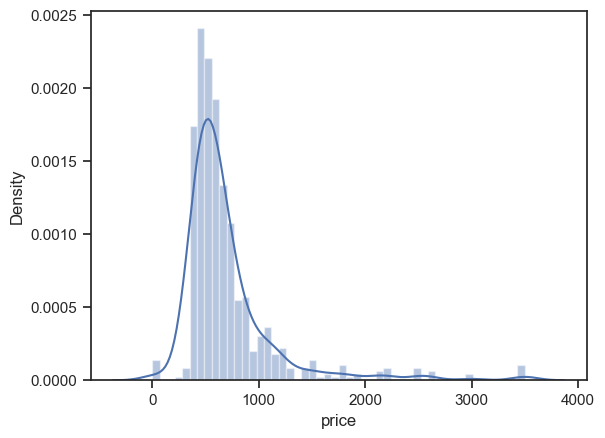

In [36]:
sns.distplot(house22['price'])
print("Skewness: %f" % house22['price'].skew())
print("Kurtosis: %f" % house22['price'].kurt())
plt.savefig("../plots/price_distribution.png")
plt.show()


It is evident that the distribution of the data is similar to the normal distribution, but the "normal distribution" is a left-skewed normal distribution. In order to measure the degree of skewness of the value, we measure the kurtosis and skewness. The peak state of distribution is steep (high tip) since kurtosis is larger than 0. At the same time, the larger the absolute value of skewness, the more serious the deviation degree of distribution. For a more normally distributed plot, we do a log transformation.

/Users/yaojie/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


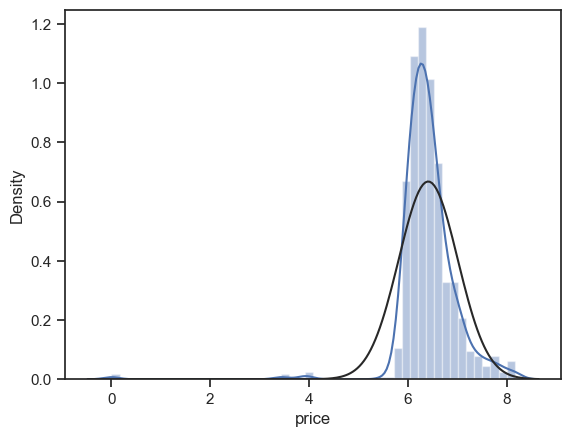

In [37]:
from scipy.stats import norm
house22["price"] = np.log1p(house22["price"])
sns.distplot(house22['price'],fit=norm )
plt.savefig("../plots/price_density.png")
plt.show()

In above figure, the black line is the normal distribution curve, and the blue line is the fitted curve. And we can see that the skewness has been corrected and the data look more normally distributed.

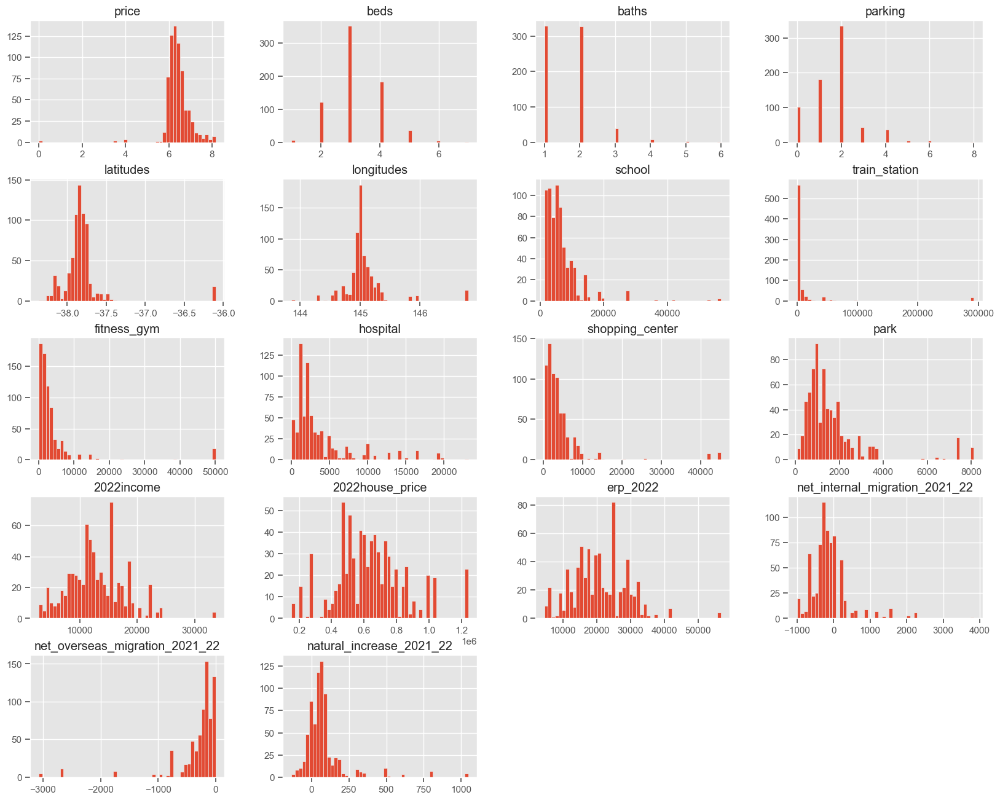

In [38]:
# draw bar charts for each numerical attribute
%matplotlib inline
from matplotlib import pyplot as plt
plt.style.use('ggplot')
house22.hist(bins=50,figsize=(20,16))
plt.savefig("../plots/bar_charts_features.png")
plt.show()